In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
color_pal = sns.color_palette()
plt.style.use('fivethirtyeight')

In [30]:
data = pd.read_csv("/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/data/dataset/EnergyData.csv",
                    index_col=[0], parse_dates=[0])
data = data.sort_index()
columnstodrop = ['respondent','respondent-name','fueltype','type-name','value-units']
data.drop(columns=columnstodrop, axis=1, inplace=True) 
data.head()

,value
period,
2022-01-01 00:00:00,3962
2022-01-01 01:00:00,3970
2022-01-01 02:00:00,3963
2022-01-01 03:00:00,3750
2022-01-01 04:00:00,3513


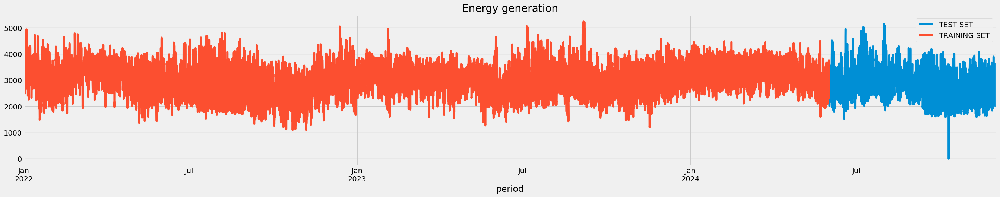

In [31]:
# Train-Test Split
split_date = '1-June-2024'
df_train = data.loc[data.index <= split_date].copy()
df_test = data.loc[data.index > split_date].copy()  

df_test.rename(columns={'value': 'TEST SET'}).join(df_train.rename(columns={'value': 'TRAINING SET'}),
          how='outer').plot(figsize=(30, 5), title='Energy generation', style='-', ms=1)
plt.show()

In [32]:
# Format data for prophet model using ds and y
df_train_prophet = df_train.reset_index().rename(columns={'period':'ds','value':'y'})
df_train_prophet['ds'] = pd.to_datetime(df_train_prophet['ds'])
df_test_prophet = df_test.reset_index().rename(columns={'period':'ds','value':'y'})
df_test_prophet['ds'] = pd.to_datetime(df_test_prophet['ds']) 

### Prophet Model 1

In [33]:
import time
from prophet import Prophet
start_time = time.time() 
m1 = Prophet(interval_width=0.95, daily_seasonality=True)
m1.fit(df_train_prophet) 
end_time = time.time()
print(f"Execution Time: {end_time - start_time:.2f} seconds") 

20:06:27 - cmdstanpy - INFO - Chain [1] start processing
20:06:58 - cmdstanpy - INFO - Chain [1] done processing


Execution Time: 34.90 seconds


In [34]:
# Predict on test set with model 
df_test_forecast = m1.predict(df_test_prophet) 

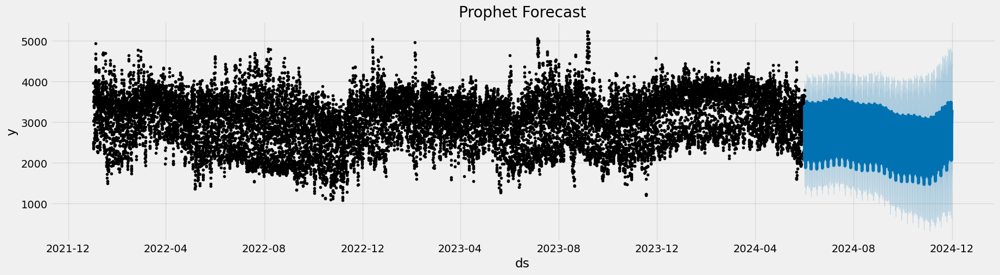

In [35]:
fig, ax = plt.subplots(figsize=(20, 5))
fig = m1.plot(df_test_forecast , ax=ax)
ax.set_title('Prophet Forecast')
plt.show()

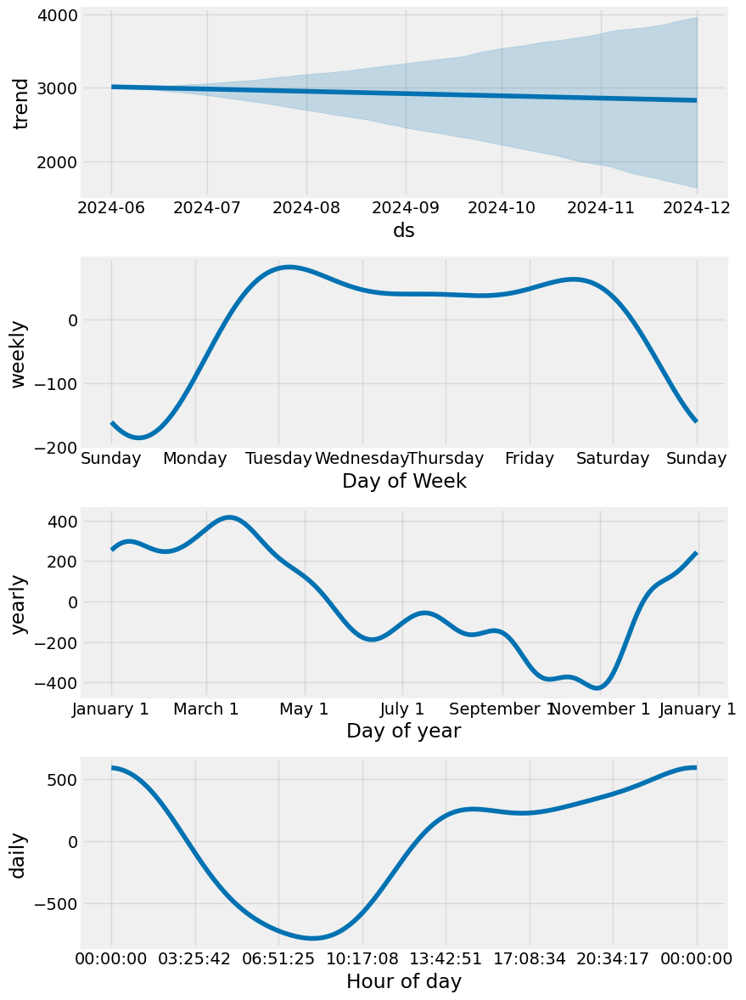

In [36]:
fig = m1.plot_components(df_test_forecast)
plt.show()

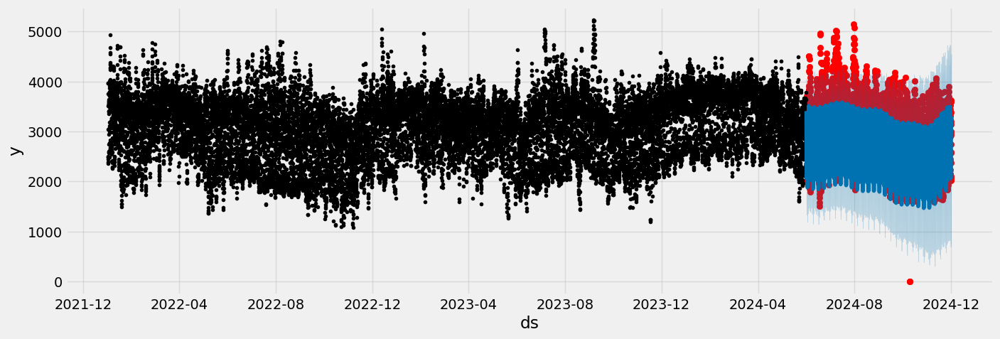

In [9]:
# Plot the forecast with the actuals
f, ax = plt.subplots(figsize=(15, 5))
ax.scatter(df_test.index, df_test['value'], color='r')
fig = m1.plot(df_test_forecast, ax=ax)

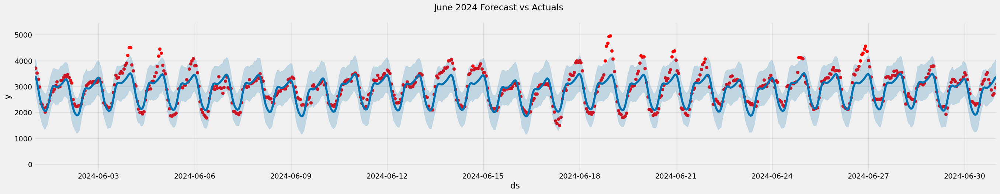

In [10]:
fig, ax = plt.subplots(figsize=(30, 5))
ax.scatter(df_test.index, df_test['value'], color='r')
fig = m1.plot(df_test_forecast, ax=ax) 
lower_bound = pd.to_datetime('2024-06-01') 
upper_bound = pd.to_datetime('2024-07-01') 
ax.set_xbound(lower=lower_bound, upper=upper_bound)
plot = plt.suptitle('June 2024 Forecast vs Actuals')
plt.show() 

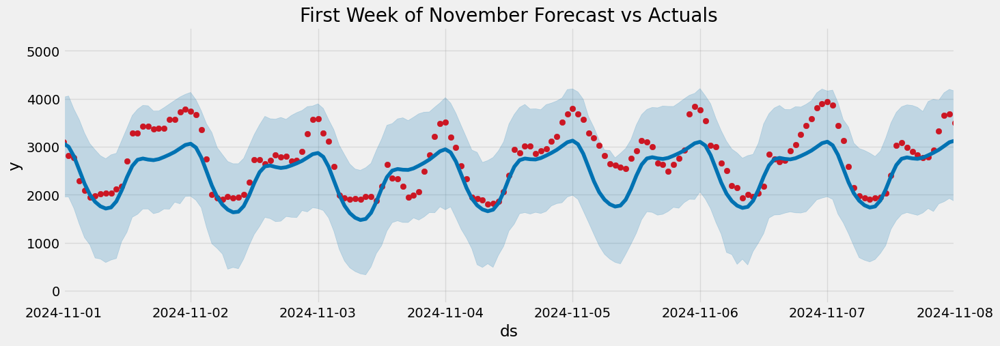

In [11]:
# Plot the forecast with the actuals
f, ax = plt.subplots(figsize=(15, 5))
ax.scatter(df_test.index, df_test['value'], color='r')
fig = m1.plot(df_test_forecast, ax=ax)

lower_bound = pd.to_datetime('2024-11-01')  # Use 'YYYY-MM-DD' format
upper_bound = pd.to_datetime('2024-11-08')

ax.set_xbound(lower=lower_bound, upper=upper_bound) 
ax.set_title('First Week of November Forecast vs Actuals')
plt.show()

In [37]:
import joblib
joblib.dump(m1, "/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/models/prophet_m1.pkl")

['/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/models/prophet_m1.pkl']

###  Prophet Model 2

In [16]:
df = data.reset_index().rename(columns={'period':'ds', 'value':'y'}) 
df['ds'] = pd.to_datetime(df['ds'], format='%Y-%m-%dT%H')
print(type(df))
df.head()

<class 'pandas.core.frame.DataFrame'>


,ds,y
0,2022-01-01 00:00:00,3962
1,2022-01-01 01:00:00,3970
2,2022-01-01 02:00:00,3963
3,2022-01-01 03:00:00,3750
4,2022-01-01 04:00:00,3513


In [17]:
m2 = Prophet()
m2.fit(df)

20:00:10 - cmdstanpy - INFO - Chain [1] start processing
20:00:44 - cmdstanpy - INFO - Chain [1] done processing


In [18]:
# Save the trained model 
joblib.dump(m2, "/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/models/prophet_m2.pkl")

['/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/models/prophet_m2.pkl']

In [19]:
future = m2.make_future_dataframe(periods=365)
future.tail()

,ds
25921,2025-11-27
25922,2025-11-28
25923,2025-11-29
25924,2025-11-30
25925,2025-12-01


In [25]:
forecast = m2.predict(future)
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
25921,2025-11-27,2480.373467,1773.112141,4508.571273,1193.406351,3751.922783,630.608875,630.608875,630.608875,622.183091,...,42.601002,42.601002,42.601002,-34.175218,-34.175218,-34.175218,0.0,0.0,0.0,3110.982342
25922,2025-11-28,2479.254613,1739.734791,4613.820490,1184.923028,3755.534085,656.853732,656.853732,656.853732,622.183091,...,56.126333,56.126333,56.126333,-21.455692,-21.455692,-21.455692,0.0,0.0,0.0,3136.108344
25923,2025-11-29,2478.135759,1761.800888,4547.266526,1177.415087,3759.145386,643.404754,643.404754,643.404754,622.183091,...,30.780096,30.780096,30.780096,-9.558434,-9.558434,-9.558434,0.0,0.0,0.0,3121.540513
25924,2025-11-30,2477.016905,1619.147462,4336.820274,1173.657165,3763.511672,456.771186,456.771186,456.771186,622.183091,...,-166.916877,-166.916877,-166.916877,1.504973,1.504973,1.504973,0.0,0.0,0.0,2933.788091
25925,2025-12-01,2475.898051,1668.944075,4434.876872,1165.550780,3767.450467,543.163757,543.163757,543.163757,622.183091,...,-90.756861,-90.756861,-90.756861,11.737527,11.737527,11.737527,0.0,0.0,0.0,3019.061808


In [26]:
from prophet.plot import plot_plotly, plot_components_plotly
plot_plotly(m2, forecast)

In [27]:
plot_components_plotly(m2, forecast)

###  Prophet Model 3 - Including holidays

In [3]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar

df = data.reset_index().rename(columns={'period':'ds', 'value':'y'}) 
df['ds'] = pd.to_datetime(df['ds'], format='%Y-%m-%dT%H') 
cal = calendar()
holidays = cal.holidays(start=df.index.min(),
                        end=df.index.max(),
                        return_name=True)
holiday_df = pd.DataFrame(data=holidays,
                          columns=['holiday'])
holiday_df = holiday_df.reset_index().rename(columns={'index':'ds'})

In [8]:
%%time
m3 = Prophet(holidays=holiday_df)
m3.fit(df)

19:52:21 - cmdstanpy - INFO - Chain [1] start processing
19:52:58 - cmdstanpy - INFO - Chain [1] done processing


CPU times: user 4.38 s, sys: 403 ms, total: 4.78 s
Wall time: 41.3 s


In [13]:
joblib.dump(m3, "/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/models/prophet_m3.pkl")

['/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/models/prophet_m3.pkl']

In [20]:
# Predict on training set with model
forecast_with_holidays = m3.predict(df=future)

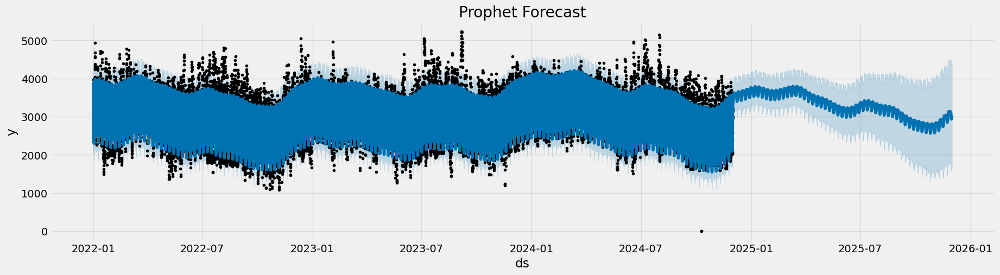

In [22]:
fig, ax = plt.subplots(figsize=(20, 5))
fig = m3.plot(forecast_with_holidays , ax=ax)
ax.set_title('Prophet Forecast')
plt.show()

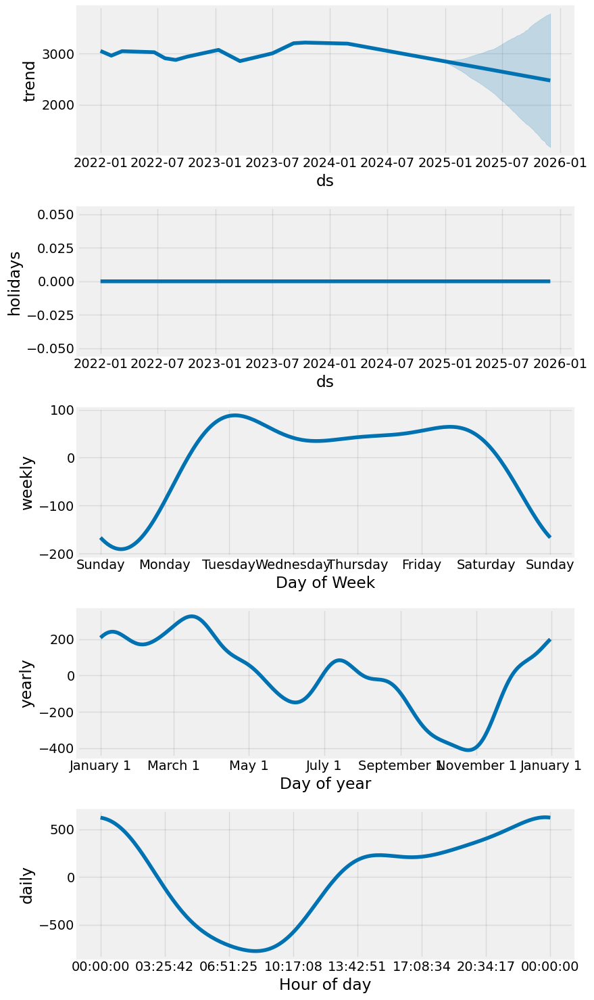

In [24]:
fig = m3.plot_components(forecast_with_holidays)
plt.show()